# Covid-19 Analysis India vs The World
## Prerequsites 

In [1]:
# Installs
!pip install pycountry_convert 
!pip install folium
!pip install calmap

## Importing The Required Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import ticker 
import pycountry_convert as pc
import folium
import branca
from datetime import datetime, timedelta,date
from scipy.interpolate import make_interp_spline, BSpline
import plotly.express as px
import json, requests
import calmap

from keras.layers import Input, Dense, Activation, LeakyReLU, Dropout
from keras import models
from keras.optimizers import RMSprop, Adam

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

Using TensorFlow backend.


In [3]:
# Jhon hopkins Dataset
df_confirmed = pd.read_csv('C:\\Users\\Samyak\\Downloads\\COVID-19-master\\csse_covid_19_data\\csse_covid_19_time_series\\time_series_covid19_confirmed_global.csv')
df_deaths = pd.read_csv('C:\\Users\\Samyak\\Downloads\\COVID-19-master\\csse_covid_19_data\\csse_covid_19_time_series\\time_series_covid19_deaths_global.csv')
df_recovered = pd.read_csv('C:\\Users\\Samyak\\Downloads\\COVID-19-master\\csse_covid_19_data\\csse_covid_19_time_series\\time_series_covid19_recovered_global.csv')

df_covid19 = pd.read_csv("C:\\Users\\Samyak\\Downloads\\COVID-19-master\\data\\cases_country.csv")
df_table = pd.read_csv("C:\\Users\\Samyak\\Downloads\\COVID-19-master\\data\\cases_time.csv",parse_dates=['Last_Update'])

In [4]:
#new dataset 
df_covid19 = df_covid19.drop(["People_Tested","People_Hospitalized","UID","ISO3","Mortality_Rate"],axis =1)
df_covid19.head(2)

,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Incident_Rate
0,Australia,2020-07-29 10:35:03,-25.0000,133.0000,15583.0,176.0,9619.0,5788.0,61.206534
1,Austria,2020-07-29 10:35:03,47.5162,14.5501,20850.0,716.0,18528.0,1606.0,231.502043


In [5]:
df_confirmed.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,7/19/20,7/20/20,7/21/20,7/22/20,7/23/20,7/24/20,7/25/20,7/26/20,7/27/20,7/28/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,35475,35526,35615,35727,35928,35981,36036,36157,36263,36368
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,4090,4171,4290,4358,4466,4570,4637,4763,4880,4997
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,23084,23691,24278,24872,25484,26159,26764,27357,27973,28615
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,880,884,884,889,889,897,897,897,907,907
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,705,749,779,812,851,880,916,932,950,1000


In [6]:
df_deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,7/19/20,7/20/20,7/21/20,7/22/20,7/23/20,7/24/20,7/25/20,7/26/20,7/27/20,7/28/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,1181,1185,1186,1190,1211,1225,1248,1259,1269,1270
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,112,113,117,120,123,128,134,138,144,148
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,1078,1087,1100,1111,1124,1136,1146,1155,1163,1174
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,52,52,52,52,52,52,52,52,52,52
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,29,29,30,33,33,35,39,40,41,47


In [7]:
df_table.head()

,Country_Region,Last_Update,Confirmed,Deaths,Recovered,Active,Delta_Confirmed,Delta_Recovered,Incident_Rate,People_Tested,People_Hospitalized,Province_State,FIPS,UID,iso3,Report_Date_String,Delta_Deaths
0,Afghanistan,2020-01-22,0,0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,4,AFG,2020/01/22,0.0
1,Afghanistan,2020-01-23,0,0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,4,AFG,2020/01/23,0.0
2,Afghanistan,2020-01-24,0,0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,4,AFG,2020/01/24,0.0
3,Afghanistan,2020-01-25,0,0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,4,AFG,2020/01/25,0.0
4,Afghanistan,2020-01-26,0,0,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,4,AFG,2020/01/26,0.0


## Preprocessing of Datasets

In [8]:
df_confirmed = df_confirmed.rename(columns={"Province/State":"state","Country/Region": "country"})
df_deaths = df_deaths.rename(columns={"Province/State":"state","Country/Region": "country"})
df_covid19 = df_covid19.rename(columns={"Country_Region": "country"})
df_covid19["Active"] = df_covid19["Confirmed"]-df_covid19["Recovered"]-df_covid19["Deaths"]
df_recovered = df_recovered.rename(columns={"Province/State":"state","Country/Region": "country"})
df_confirmed.head()

,state,country,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,7/19/20,7/20/20,7/21/20,7/22/20,7/23/20,7/24/20,7/25/20,7/26/20,7/27/20,7/28/20
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,35475,35526,35615,35727,35928,35981,36036,36157,36263,36368
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,4090,4171,4290,4358,4466,4570,4637,4763,4880,4997
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,23084,23691,24278,24872,25484,26159,26764,27357,27973,28615
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,880,884,884,889,889,897,897,897,907,907
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,705,749,779,812,851,880,916,932,950,1000


In [10]:
# getting all countries
countries = np.asarray(df_confirmed["country"])
countries1 = np.asarray(df_covid19["country"])
# Continent_code to Continent_names
continents = {
    'NA': 'North America',
    'SA': 'South America', 
    'AS': 'Asia',
    'OC': 'Australia',
    'AF': 'Africa',
    'EU' : 'Europe',
    'na' : 'Others'
}

# Defininng Function for getting continent code for country.
def country_to_continent_code(country):
    try:
        return pc.country_alpha2_to_continent_code(pc.country_name_to_country_alpha2(country))
    except :
        return 'na'

#Collecting Continent Information
df_confirmed.insert(2,"continent", [continents[country_to_continent_code(country)] for country in countries[:]])
df_deaths.insert(2,"continent",  [continents[country_to_continent_code(country)] for country in countries[:]])
df_covid19.insert(1,"continent",  [continents[country_to_continent_code(country)] for country in countries1[:]])
df_table.insert(1,"continent",  [continents[country_to_continent_code(country)] for country in df_table["Country_Region"].values])
df_recovered.insert(1,"continent",  [continents[country_to_continent_code(country)] for country in countries[:]] ) 

ValueError: cannot insert continent, already exists

# General Analysis of Data

Getting country wise and continent wise data.

In [11]:
df_countries_cases = df_covid19.copy().drop(['Lat','Long_','continent','Last_Update'],axis =1)
df_countries_cases.index = df_countries_cases["country"]
df_countries_cases = df_countries_cases.drop(['country'],axis=1)

df_continents_cases = df_covid19.copy().drop(['Lat','Long_','country','Last_Update'],axis =1)
df_continents_cases = df_continents_cases.groupby(["continent"]).sum()

df_countries_cases.fillna(0,inplace=True)
df_continents_cases.fillna(0,inplace=True)

### Global Reported Cases till Date
Total number of confirmed cases, deaths reported, revoveries and active cases all across the world

In [12]:
df_t = pd.DataFrame(pd.to_numeric(df_countries_cases.sum()),dtype=np.float64).transpose()
df_t["Mortality Rate (per 100)"] = np.round(100*df_t["Deaths"]/df_t["Confirmed"],2)
df_t.style.background_gradient(cmap='Reds',axis=1).format("{:.2f}").format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])

,Confirmed,Deaths,Recovered,Active,Incident_Rate,Mortality Rate (per 100)
0,16760915,660978,9769747,6232422,53268.14,3.94


### Coninent Wise Reported Cases in the world 
Coninent Wise reported confirmed cases, recovered cases, deaths, active cases

In [13]:
df_continents_cases["Mortality Rate (per 100)"] = np.round(100*df_continents_cases["Deaths"]/df_continents_cases["Confirmed"],2)
df_continents_cases.style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Recovered"])\
                        .background_gradient(cmap='Purples',subset=["Active"])\
                        .background_gradient(cmap='Pastel1_r',subset=["Incident_Rate"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}")\
                        .format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])

,Confirmed,Deaths,Recovered,Active,Incident_Rate,Mortality Rate (per 100)
continent,,,,,,
Africa,846240,18137,507253,320850,4445.02,2.14
Asia,4039177,92690,2935090,1011397,17522.23,2.29
Australia,17232,198,11162,5872,97.25,1.15
Europe,2814973,202272,1629974,884966,16476.32,7.19
North America,781008,60236,539168,181604,4466.74,7.71
Others,4414574,150222,1395202,2869143,3602.84,3.40
South America,3847711,137223,2751898,958590,6657.73,3.57


### Country Wise Reported Cases in the world 
Coninent Wise reported confirmed cases, recovered cases, deaths, active cases

In [14]:
# df_countries_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='Wistia')
df_countries_cases["Mortality Rate (per 100)"] = np.round(100*df_countries_cases["Deaths"]/df_countries_cases["Confirmed"],2)
df_countries_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Recovered"])\
                        .background_gradient(cmap='Purples',subset=["Active"])\
                        .background_gradient(cmap='Pastel1_r',subset=["Incident_Rate"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}")\
                        .format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])

,Confirmed,Deaths,Recovered,Active,Incident_Rate,Mortality Rate (per 100)
country,,,,,,
US,4352304,149260,1355363,2847681,1321.02,3.43
Brazil,2483191,88539,1868749,525903,1168.23,3.57
India,1531669,34193,988029,509447,110.99,2.23
Russia,827455,13642,619134,194679,567.00,1.65
South Africa,459761,7257,287313,165191,775.20,1.58
Mexico,402697,44876,308142,49679,315.12,11.14
Peru,395005,18612,276452,99941,1198.01,4.71
Chile,349800,9240,322332,18228,1829.86,2.64
United Kingdom,302295,45963,1438,254894,445.30,15.20


## Cases in India reported till date 

In [15]:
df_ind = df_countries_cases.iloc[26, :]
df_india_cases = pd.DataFrame(df_ind).transpose()
df_india_cases["Mortality Rate (per 100)"] = np.round(100*df_india_cases["Deaths"]/df_countries_cases["Confirmed"],2)
df_india_cases.style.background_gradient(cmap='Blues',axis=1).format("{:.2f}").format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])

,Confirmed,Deaths,Recovered,Active,Incident_Rate,Mortality Rate (per 100)
India,1531669,34193,988029,509447,110.99,2.23


### Top 5 countries (Confirmed Cases and Deaths)

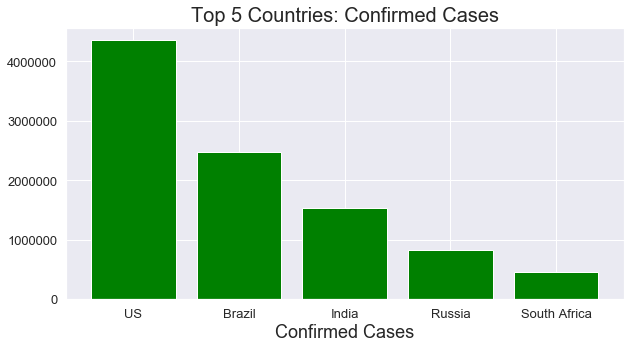

In [16]:
import seaborn as sns
sns.set(style="darkgrid")

f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True).invert_xaxis()
plt.bar(df_countries_cases.sort_values('Confirmed')["Confirmed"].index[-5:],df_countries_cases.sort_values('Confirmed')["Confirmed"].values[-5:],color="green")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Confirmed Cases",fontsize=18)
plt.title("Top 5 Countries: Confirmed Cases",fontsize=20)
plt.show()

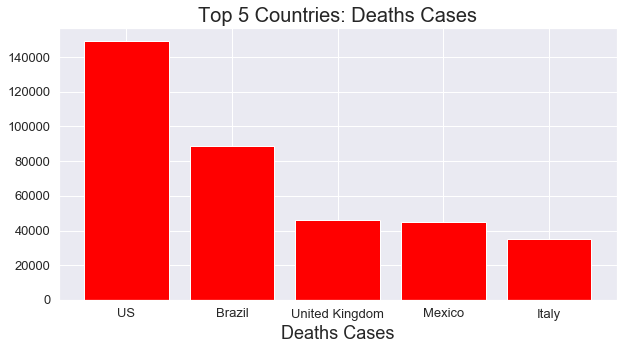

In [17]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True).invert_xaxis()
plt.bar(df_countries_cases.sort_values('Deaths')["Deaths"].index[-5:],df_countries_cases.sort_values('Deaths')["Deaths"].values[-5:],color="red")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Deaths Cases",fontsize=18)
plt.title("Top 5 Countries: Deaths Cases",fontsize=20)
plt.show()

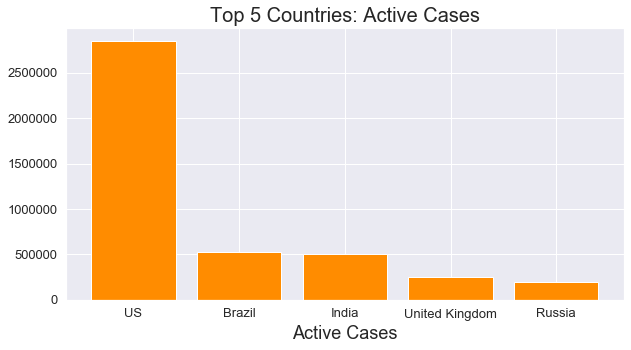

In [18]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True).invert_xaxis()
plt.bar(df_countries_cases.sort_values('Active')["Active"].index[-5:],df_countries_cases.sort_values('Active')["Active"].values[-5:],color="darkorange")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Active Cases",fontsize=18)
plt.title("Top 5 Countries: Active Cases",fontsize=20)
plt.show()

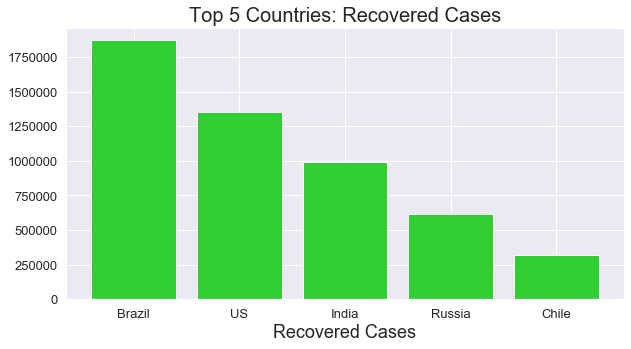

In [19]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True).invert_xaxis()
plt.bar(df_countries_cases.sort_values('Recovered')["Recovered"].index[-5:],df_countries_cases.sort_values('Recovered')["Recovered"].values[-5:],color="limegreen")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Recovered Cases",fontsize=18)
plt.title("Top 5 Countries: Recovered Cases",fontsize=20)
plt.show()

# Correlation Analysis
### Country Wise Correlation

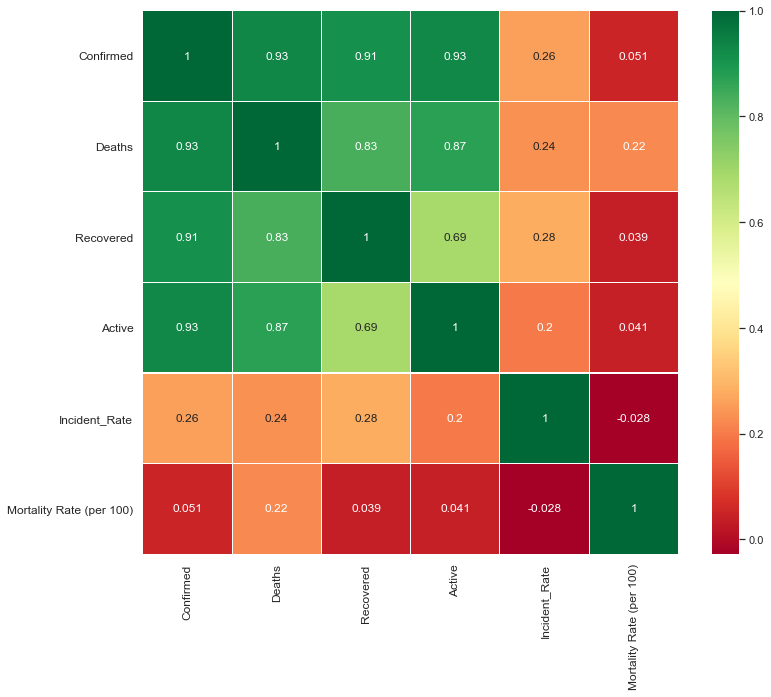

In [20]:
corr = df_countries_cases.corr()
ax = sns.heatmap(corr,annot=True,cmap='RdYlGn',linewidths=0.1,annot_kws={'size':12})
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
fig=plt.gcf()
fig.set_size_inches(12,10)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

# Visulization using Maps(Folium)
## 1) The World

In [21]:
world_map = folium.Map(location=[10,0], tiles="cartodbpositron", zoom_start=2,max_zoom=8,min_zoom=2)
for i in range(0,len(df_confirmed)):
    folium.Circle(
        location=[df_confirmed.iloc[i]['Lat'], df_confirmed.iloc[i]['Long']],
        tooltip = "<h5 style='text-align:center;font-weight: bold'>"+df_confirmed.iloc[i]['country']+"</h5>"+
                    "<div style='text-align:center;'>"+str(np.nan_to_num(df_confirmed.iloc[i]['state']))+"</div>"+
                    "<hr style='margin:10px;'>"+
                    "<ul style='color: #444;list-style-type:circle;align-item:left;padding-left:20px;padding-right:20px'>"+
        "<li>Confirmed: "+str(df_confirmed.iloc[i,-1])+"</li>"+
        "<li>Deaths:   "+str(df_deaths.iloc[i,-1])+"</li>"+
        "<li>Mortality Rate:   "+str(np.round(df_deaths.iloc[i,-1]/(df_confirmed.iloc[i,-1]+1.00001)*100,2))+"</li>"+
        "</ul>"
        ,
        radius=(int((np.log(df_confirmed.iloc[i,-1]+1.00001)))+0.2)*50000,
        color='#ff6600',
        fill_color='red',
        fill=True).add_to(world_map)

world_map


## Global Confirmed Cases Visualization Using: Choropleth Maps 

In [22]:
temp_df = pd.DataFrame(df_countries_cases['Confirmed'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Confirmed"]), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Confirmed"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Confirmed Cases Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Confirmed Cases(Log Scale)",colorscale="Blues")
fig.show()

## Global Recovered Cases Visualization Using: Choropleth Maps 

In [23]:
temp_df = pd.DataFrame(df_countries_cases['Recovered'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df.iloc[:,-1]+1), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Recovered"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Recovered Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Recovered",colorscale="Greens")

fig.show()

## Global Deaths Cases Visualization Using: Choropleth Maps 

In [24]:
temp_df = pd.DataFrame(df_countries_cases['Deaths'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Deaths"]+1), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Deaths"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Deaths Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Deaths (Log Scale)",colorscale="Reds")
fig.show()

# COVID-19 Spread Analysis
## 1. Spread Across World

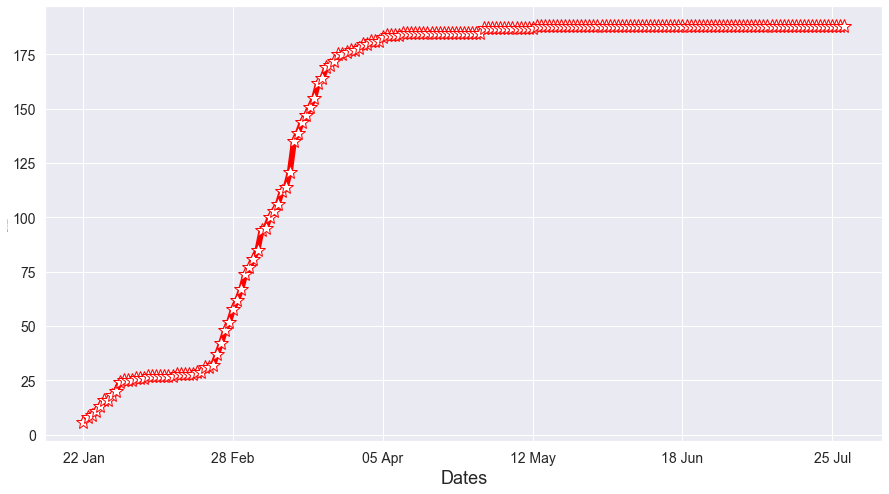

In [25]:
case_nums_country = df_confirmed.groupby("country").sum().drop(['Lat','Long'],axis =1).apply(lambda x: x[x > 0].count(), axis =0)
d = [datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in case_nums_country.index]

f = plt.figure(figsize=(15,8))
f.add_subplot(111)
marker_style = dict(c="red",linewidth=6, linestyle='-', marker='*',markersize=15, markerfacecolor='#ffffff')
plt.plot(d, case_nums_country,**marker_style)
plt.tick_params(labelsize = 14)
plt.xticks(list(np.arange(0,len(d),int(len(d)/5))),d[:-1:int(len(d)/5)]+[d[-1]])

#labels
plt.xlabel("Dates",fontsize=18)
plt.ylabel("Number of Countries/Regions",fontsize=1)
plt.show()
plt.close()

## 2. Spread Across Progression

In [26]:

df_data = df_table.groupby(['Last_Update', 'Country_Region'])['Confirmed', 'Deaths'].max().reset_index().fillna(0)
df_data["Last_Update"] = pd.to_datetime( df_data["Last_Update"]).dt.strftime('%m/%d/%Y')

fig = px.scatter_geo(df_data, locations="Country_Region", locationmode='country names', 
                     color=np.power(df_data["Confirmed"],0.3)-2 , size= np.power(df_data["Confirmed"]+1,0.3)-1, hover_name="Country_Region",
                     hover_data=["Confirmed"],
                     range_color= [0, max(np.power(df_data["Confirmed"],0.3))], 
                     projection="natural earth", animation_frame="Last_Update", 
                     color_continuous_scale=px.colors.sequential.Plasma,
                     title='COVID-19: Progression of spread'
                    )
fig.update_coloraxes(colorscale="hot")
fig.update(layout_coloraxis_showscale=False)
fig.show()

# COVID-19 Spread Comparison of few most affected countries and INDIA in First 100 days

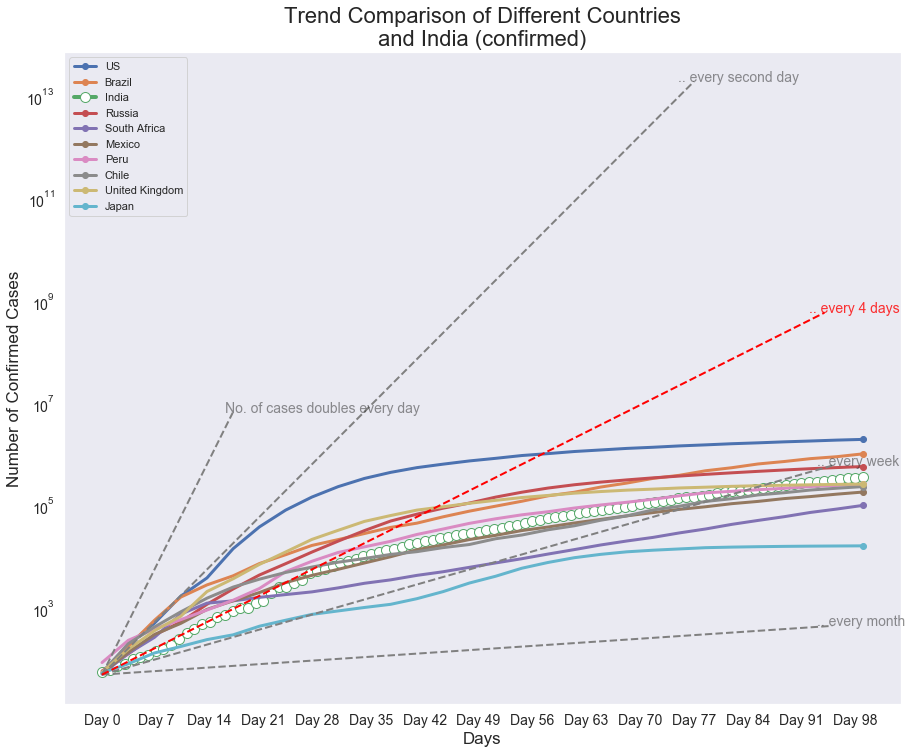

In [27]:
temp = df_confirmed.groupby('country').sum().drop(["Lat","Long"],axis =1).sort_values(df_confirmed.columns[-1], ascending= False)

threshold = 50
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    if i >= 9:
        if country != "India" and country != "Japan" :
            continue
    days = 100
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 30)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    if country != "India":
        plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])
    else:
        marker_style = dict(linewidth=4, linestyle='-', marker='o',markersize=10, markerfacecolor='#ffffff')
        plt.plot(date,t,"-.",label = country,**marker_style)

plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-22))
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-4))
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-4))
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)


# India is following trend similar to doulbe the cases in 4 days but it may increase the rate 
x = np.arange(0,int(days-5))
y = 2**(x/4+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "Red")
plt.annotate(".. every 4 days",(x[-3],y[-1]),color="Red",xycoords="data",fontsize=14,alpha = 0.8)

# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Confirmed Cases",fontsize=17)
plt.title("Trend Comparison of Different Countries\n and India (confirmed) ",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.show()

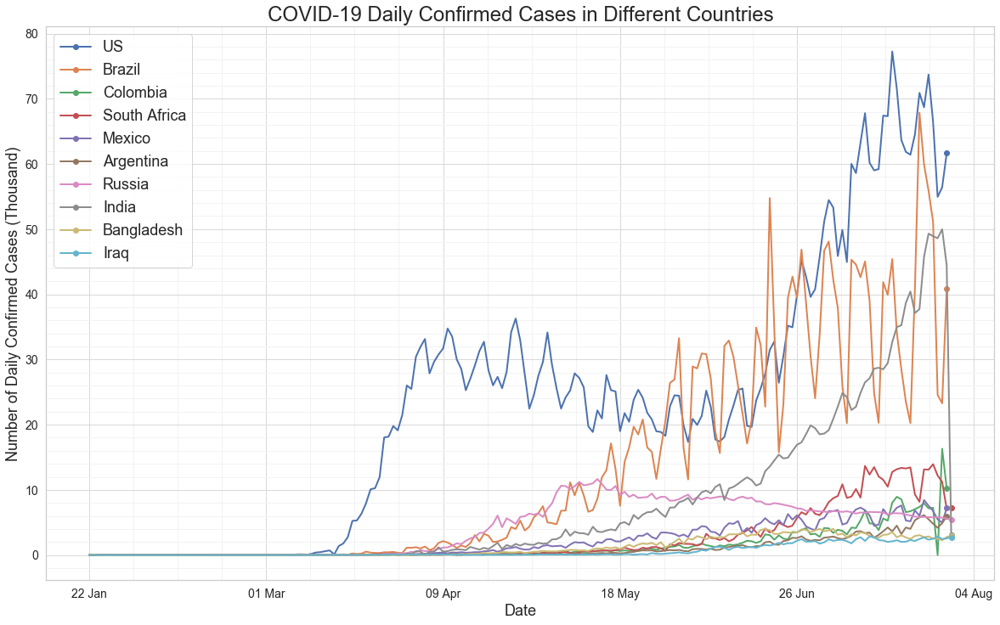

In [28]:
sns.set(style="whitegrid")
thoudand = 1000
temp = df_confirmed.groupby('country').sum().diff(axis=1).sort_values(df_deaths.columns[-1],ascending =False).head(10).replace(np.nan,0)
threshold = 0
f = plt.figure(figsize=(20,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    t = temp.loc[temp.index== country].values[0]
    t = t[t>=threshold]
    
    date = np.arange(0,len(t[:]))
    plt.plot(date,t/thoudand,'-o',label = country,linewidth =2, markevery=[-1])


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,7+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=14)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Daily Confirmed Cases in Different Countries",{'fontsize':24})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Confirmed Cases (Thousand)",fontsize =18)

# plt.yscale("log")
plt.legend(fontsize=18) 
plt.show()

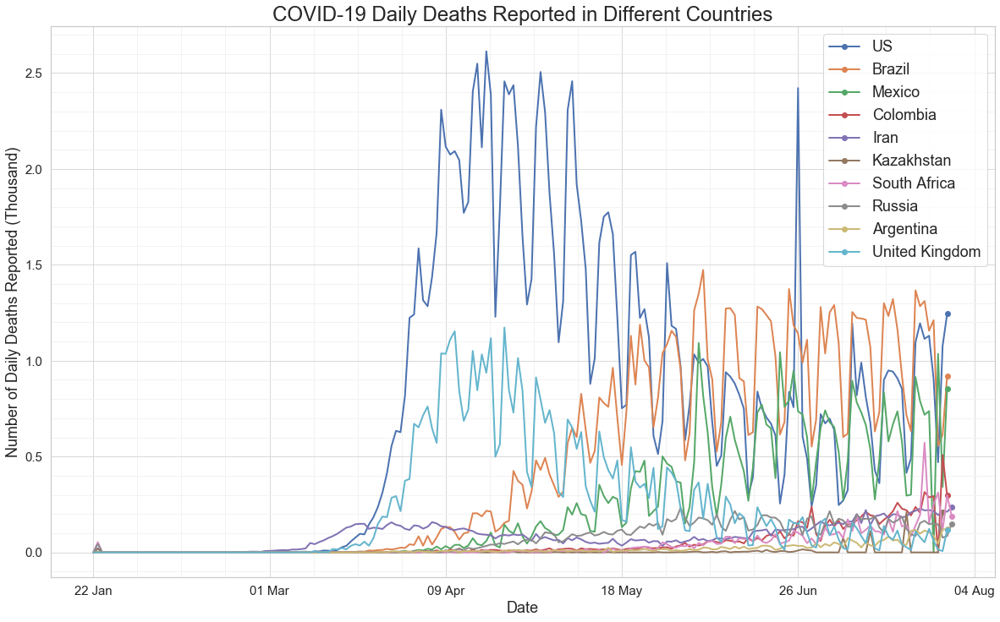

In [29]:
thoudand = 1000
temp = df_deaths.groupby('country').sum().diff(axis=1).sort_values(df_deaths.columns[-1],ascending =False).head(10).replace(np.nan,0)
threshold = 0
f = plt.figure(figsize=(20,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    t = temp.loc[temp.index== country].values[0]
    t = t[t>=threshold]
    
    date = np.arange(0,len(t[:]))
    plt.plot(date,t/thoudand,'-o',label = country,linewidth =2, markevery=[-1])


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,7+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=15)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Daily Deaths Reported in Different Countries",{'fontsize':24})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Deaths Reported (Thousand)",fontsize =18)

# plt.yscale("log")
plt.legend(fontsize=18) 
plt.show()

# COVID-19: Change in Mortality Rate of Each Countries Over Time

In [30]:
df_data = df_table.groupby(['Last_Update', 'Country_Region'])['Confirmed', 'Deaths','continent'].max().reset_index().fillna(0)
df_data["Last_Update"] = pd.to_datetime( df_data["Last_Update"]).dt.strftime('%m/%d/%Y')

fig = px.scatter(df_data, y=100*df_data["Deaths"]/(df_data["Confirmed"]+1),
                    x= df_data["Confirmed"]+1,
                    range_y = [-1,18],
                    range_x = [1,df_data["Confirmed"].max()+10000],
                    color= "continent", hover_name="Country_Region",
                    hover_data=["Confirmed","Deaths"],
                    range_color= [0, max(np.power(df_data["Confirmed"],0.3))], 
                    animation_frame="Last_Update", 
                    animation_group="Country_Region",
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title='COVID-19: Change in Mortality Rate of Each Countries Over Time',
                    size = np.power(df_data["Confirmed"]+1,0.3)-0.5,
                    size_max = 30,
                    log_x=True,
                    height =700,
                    )
fig.update_coloraxes(colorscale="hot")
fig.update(layout_coloraxis_showscale=False)
fig.update_xaxes(title_text="Confirmed Cases (Log Scale)")
fig.update_yaxes(title_text="Mortality Rate (%)")
fig.show()

## India Vs Outside India First 100 days

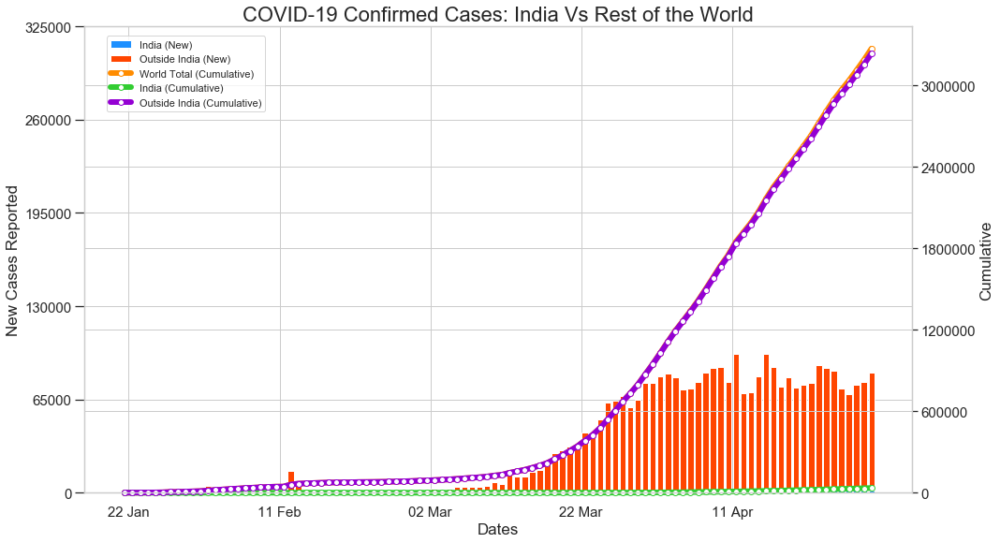

In [31]:
# Getting data for India and Oouside India
# df - Cumulative data for India, outside India and world total  (confirmed cases)
# df_newcases- new cases reported per day  (confirmed cases)
df_confirmed_report = df_confirmed.iloc[:,:105].copy()
df_confirmed_report.loc[df_confirmed_report['country'] != "India","country"] = "Outside India"
df_confirmed_report = df_confirmed_report.groupby("country").sum().drop(["Lat","Long"],axis =1)
df_confirmed_report.loc["Total"] = df_confirmed_report.sum()
df_confirmed_newcases = df_confirmed_report.groupby(level =0).diff(axis =1)
df_confirmed_newcases = df_confirmed_newcases.replace(np.nan, 0, regex=True) 
f = plt.figure(figsize=(15,8))
ax1 = f.add_subplot(111)

ax1.bar(df_confirmed_report[df_confirmed_report.index == "India"].columns,df_confirmed_newcases[df_confirmed_newcases.index == "India"].values[0], label = "India (New)",color='dodgerblue')
ax1.bar(df_confirmed_report[df_confirmed_report.index == "Outside India"].columns,df_confirmed_newcases[df_confirmed_newcases.index == "Outside India"].values[0],bottom=df_confirmed_newcases[df_confirmed_newcases.index == "India"].values[0],label = "Outside India (New)",color='orangered')

# Labels
ax1.set_xlabel("Dates",fontsize=17)
ax1.set_ylabel("New Cases Reported",fontsize =17)

ax1.tick_params(size=10,labelsize=15)
length = len(df_confirmed_report.columns)
ax1.set_xticks(np.arange(0.5, length, int(length/5)))
ax1.set_xticklabels([datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in df_confirmed_report.columns][::int(length/5)],fontsize=15)
l = np.arange(0, df_confirmed_report.max(axis = 1)[2]/10+10000, 5000)
ax1.set_yticks(l[::int(len(l)/5)])
# ax1.spines['bottom'].set_position('zero')

ax2 = ax1.twinx()
marker_style = dict(linewidth=6, linestyle='-', marker='o',markersize=6, markerfacecolor='#ffffff')

ax2.plot(df_confirmed_report[df_confirmed_report.index == "Total"].columns ,df_confirmed_report[df_confirmed_report.index == "Total"].values[0],**marker_style,label = "World Total (Cumulative)",color="darkorange",clip_on=False)
ax2.plot(df_confirmed_report[df_confirmed_report.index == "India"].columns ,df_confirmed_report[df_confirmed_report.index == "India"].values[0],**marker_style,label = "India (Cumulative)",color="limegreen",clip_on=False)
ax2.plot(df_confirmed_report[df_confirmed_report.index == "Outside India"].columns ,df_confirmed_report[df_confirmed_report.index == "Outside India"].values[0],**marker_style,label ="Outside India (Cumulative)",color="darkviolet",clip_on=False)
ax2.bar([0],[0])

# Label
ax2.tick_params(labelsize=15)
ax2.set_ylabel("Cumulative",fontsize =17)
ax2.set_xticks(np.arange(0.5, length, int(length/5)))
ax2.set_xticklabels([datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in df_confirmed_report.columns][::int(length/5)],fontsize=15)
l = np.arange(0, df_confirmed_report.max(axis = 1)[2]+100000, 100000)
ax2.set_yticks(l[::int(len(l)/5)])

f.tight_layout()
f.legend(loc = "upper left", bbox_to_anchor=(0.1,0.95))
plt.title("COVID-19 Confirmed Cases: India Vs Rest of the World",fontsize = 22)
plt.show()


In [32]:
from plotly.subplots import make_subplots
import googlemaps
import re 
import pycountry
import pycountry_convert as pc
import requests

import os

sns.set()
import pycountry
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot 
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot

!pip install pywaffle
from pywaffle import Waffle

py.init_notebook_mode(connected=True)
import folium 
from folium import plugins
plt.style.use("fivethirtyeight")# for pretty graphs

# Increase the default plot size and set the color scheme
plt.rcParams['figure.figsize'] = 8, 5
#plt.rcParams['image.cmap'] = 'viridis'

for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Disable warnings 
import warnings
warnings.filterwarnings('ignore')

# India Statewise Analysis

In [33]:
df= pd.read_csv('Covid cases in India.csv')
df_india = df.copy()

# Coordinates of India States and Uts
India_coord = pd.read_csv('Indian Coordinates.csv')

#Day by day data of India, Korea and Italy
dbd_India = pd.read_excel('per_day_cases.xlsx',sheet_name='India')

df.head()

,S. No.,Name of State / UT,Total Confirmed cases,Active,Cured/Discharged/Migrated,Deaths
0,1,Andhra Pradesh,1583,1062,488,33
1,2,Andaman and Nicobar Islands,33,1,32,0
2,3,Arunachal Pradesh,1,0,1,0
3,4,Assam,43,9,33,1
4,5,Bihar,517,396,117,4


In [34]:
india_data_json = requests.get('https://api.rootnet.in/covid19-in/unofficial/covid19india.org/statewise').json()
df_india = pd.io.json.json_normalize(india_data_json['data']['statewise'])
df_india = df_india.set_index("state")

In [35]:
df_india["Mortality Rate (per 100)"]= np.round(np.nan_to_num(100*df_india["deaths"]/df_india["confirmed"]),2)
df_india.style.background_gradient(cmap='Blues',subset=["confirmed"])\
                        .background_gradient(cmap='Reds',subset=["deaths"])\
                        .background_gradient(cmap='Greens',subset=["recovered"])\
                        .background_gradient(cmap='Purples',subset=["active"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}",subset=["Mortality Rate (per 100)"])

,confirmed,recovered,deaths,active,Mortality Rate (per 100)
state,,,,,
Maharashtra,560126,390958,19063,149798,3.40
Tamil Nadu,320355,261459,5397,53499,1.68
Andhra Pradesh,264142,170924,2378,90840,0.90
Karnataka,203200,121242,3614,78335,1.78
Delhi,150652,135108,4178,11366,2.77
Uttar Pradesh,140775,88786,2280,49709,1.62
West Bengal,107323,78617,2259,26447,2.10
Bihar,94459,62507,484,31467,0.51
Telangana,88396,64284,674,23438,0.76


## Confirmed vs Recovered vs Deaths

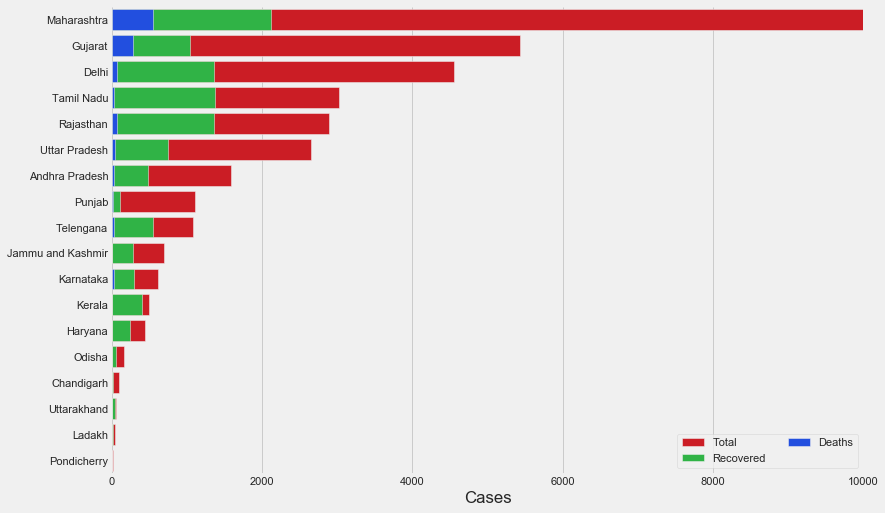

In [36]:
df_full = pd.merge(India_coord,df,on='Name of State / UT')


f, ax = plt.subplots(figsize=(12, 8))
data = df_full[['Name of State / UT','Total Confirmed cases','Cured/Discharged/Migrated','Deaths']]
data.sort_values('Total Confirmed cases',ascending=False,inplace=True)
sns.set_color_codes("bright")
sns.barplot(x="Total Confirmed cases", y="Name of State / UT", data=data,
            label="Total", color="r")

sns.set_color_codes("bright")
sns.barplot(x="Cured/Discharged/Migrated", y="Name of State / UT", data=data,
            label="Recovered", color="g")

sns.set_color_codes("bright")
sns.barplot(x="Deaths", y="Name of State / UT", data=data,
            label="Deaths", color="b")


# Add a legend and informative axis label
ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 10000), ylabel="",
       xlabel="Cases")
sns.despine(left=True, bottom=True)

In [37]:
fig = px.bar(dbd_India, x="Date", y="Total Cases", color='Total Cases', orientation='v', height=600,
             title='Confirmed Cases in India', color_discrete_sequence = px.colors.cyclical.mygbm)

fig.update_layout(plot_bgcolor='rgb(250, 242, 242)')
fig.show()

In [38]:
%%HTML
<div class="flourish-embed flourish-bar-chart-race" data-src="visualisation/2061549" data-url="https://flo.uri.sh/visualisation/2061549/embed"><script src="https://public.flourish.studio/resources/embed.js"></script></div>


In [39]:
# Adding Location data (Latitude,Longitude)
locations = {
    "Kerala" : [10.8505,76.2711],
    "Maharashtra" : [19.7515,75.7139],
    "Karnataka": [15.3173,75.7139],
    "Telangana": [18.1124,79.0193],
    "Uttar Pradesh": [26.8467,80.9462],
    "Rajasthan": [27.0238,74.2179],
    "Gujarat":[22.2587,71.1924],
    "Delhi" : [28.7041,77.1025],
    "Punjab":[31.1471,75.3412],
    "Tamil Nadu": [11.1271,78.6569],
    "Haryana": [29.0588,76.0856],
    "Madhya Pradesh":[22.9734,78.6569],
    "Jammu and Kashmir":[33.7782,76.5762],
    "Ladakh": [34.1526,77.5770],
    "Andhra Pradesh":[15.9129,79.7400],
    "West Bengal": [22.9868,87.8550],
    "Bihar": [25.0961,85.3131],
    "Chhattisgarh":[21.2787,81.8661],
    "Chandigarh":[30.7333,76.7794],
    "Uttarakhand":[30.0668,79.0193],
    "Himachal Pradesh":[31.1048,77.1734],
    "Goa": [15.2993,74.1240],
    "Odisha":[20.9517,85.0985],
    "Andaman and Nicobar Islands": [11.7401,92.6586],
    "Puducherry":[11.9416,79.8083],
    "Manipur":[24.6637,93.9063],
    "Mizoram":[23.1645,92.9376],
    "Assam":[26.2006,92.9376],
    "Meghalaya":[25.4670,91.3662],
    "Tripura":[23.9408,91.9882],
    "Arunachal Pradesh":[28.2180,94.7278],
    "Jharkhand" : [23.6102,85.2799],
    "Nagaland": [26.1584,94.5624],
    "Sikkim": [27.5330,88.5122],
    "Dadra and Nagar Haveli":[20.1809,73.0169],
    "Lakshadweep":[10.5667,72.6417],
    "Daman and Diu":[20.4283,72.8397]    
}
df_india["Lat"] = ""
df_india["Long"] = ""

for index in df_india.index :
    if index in locations:
        df_india.loc[df_india.index == index,"Lat"] = locations[index][0]
        df_india.loc[df_india.index == index,"Long"] = locations[index][1]
    else:
        df_india.drop([index],inplace=True)

In [40]:
india = folium.Map(location=[23,80], zoom_start=4,max_zoom=6,min_zoom=4,height=500,width="80%")
for i in range(0,len(df_india[df_india['confirmed']>0].index)):
    folium.Circle(
        location=[df_india.iloc[i]['Lat'], df_india.iloc[i]['Long']],
        tooltip = "<h5 style='text-align:center;font-weight: bold'>"+df_india.iloc[i].name+"</h5>"+
                    "<hr style='margin:10px;'>"+
                    "<ul style='color: #444;list-style-type:circle;align-item:left;padding-left:20px;padding-right:20px'>"+
        "<li>Confirmed: "+str(df_india.iloc[i]['confirmed'])+"</li>"+
        "<li>Active:   "+str(df_india.iloc[i]['active'])+"</li>"+
        "<li>Recovered:   "+str(df_india.iloc[i]['recovered'])+"</li>"+
        "<li>Deaths:   "+str(df_india.iloc[i]['deaths'])+"</li>"+
        
        "<li>Mortality Rate:   "+str(np.round(df_india.iloc[i]['Mortality Rate (per 100)'],2))+"</li>"+
        "</ul>"
        ,
        radius=(int(np.log2(df_india.iloc[i]['confirmed']+1)))*15000,
        color='#ff6600',
        fill_color='#ff8533',
        fill=True).add_to(india)

india  

# Geo Spatial Analysis: India (StateWise) 
## Using New Dataset From Kaggle

In [41]:
df = pd.read_csv('covid_19_india.csv')
df['Date'] = pd.to_datetime(df['Date'],format='%d/%m/%y')
df['Date'] = df['Date'].dt.date
df.rename(columns={'Date':'date','State/UnionTerritory':'state','ConfirmedIndianNational':'confirmed_in',\
                   'ConfirmedForeignNational':'confirmed_fr'}, inplace=True)
df.drop(['Sno','Time'],axis=1,inplace=True)
df['state'] = df.apply(lambda x: 'Nagaland' if x['state']=='Nagaland#' else 'Jharkhand' if x['state']=='Jharkhand#' else x['state'], axis=1)
df = df[df['state']!='Unassigned']
df.reset_index(inplace=True)

df.head()

,index,date,state,confirmed_in,confirmed_fr,Cured,Deaths,Confirmed,Unnamed: 9
0,0,2020-01-30,Kerala,1,0,0.0,0.0,1.0,NaN
1,1,2020-01-31,Kerala,1,0,0.0,0.0,1.0,NaN
2,2,2020-02-01,Kerala,2,0,0.0,0.0,2.0,NaN
3,3,2020-02-02,Kerala,3,0,0.0,0.0,3.0,NaN
4,4,2020-02-03,Kerala,3,0,0.0,0.0,3.0,NaN


In [42]:
df.tail()

,index,date,state,confirmed_in,confirmed_fr,Cured,Deaths,Confirmed,Unnamed: 9
4594,4597,2020-07-28,Tripura,-,-,2467.0,17.0,4049.0,NaN
4595,4598,2020-07-28,Uttarakhand,-,-,3675.0,66.0,6328.0,NaN
4596,4599,2020-07-28,Uttar Pradesh,-,-,42833.0,1456.0,70493.0,NaN
4597,4600,2020-07-28,West Bengal,-,-,39917.0,1411.0,60830.0,NaN
4598,4601,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
